# Load the data

In [ ]:
import warnings
warnings.filterwarnings("ignore")

import pandas as pd
import seaborn as sns 
import matplotlib.pyplot as plt
import plotly.graph_objects as go
import plotly.express as px
from plotly.offline import init_notebook_mode, iplot
from plotly import tools
from textblob import TextBlob 
from wordcloud import WordCloud, STOPWORDS
import numpy as np
from PIL import Image
import stylecloud
from IPython.display import Image
from collections import defaultdict
from collections import  Counter
import nltk
from nltk.corpus import stopwords
from sklearn.feature_extraction.text import CountVectorizer

import glob
import string, os, random
punc = string.punctuation

import gensim
from nltk.stem import WordNetLemmatizer,PorterStemmer
from nltk.tokenize import word_tokenize
import pyLDAvis.gensim_models
import pyLDAvis

/anaconda/envs/azureml_py38/lib/python3.8/site-packages/sklearn/decomposition/_lda.py:29: DeprecationWarning:

`np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations



In [ ]:
data_0 = pd.read_csv("../Dataset/data_20220717.csv")
data_1 = pd.read_csv("../Dataset/data_20220718.csv")
data_2 = pd.read_csv("../Dataset/data_20220719.csv")
data_3 = pd.read_csv("../Dataset/data_20220720.csv")
data_4 = pd.read_csv("../Dataset/data_20220721.csv")
data_5 = pd.read_csv("../Dataset/data_20220722.csv")
data_6 = pd.read_csv("../Dataset/data_20220723.csv")
data_7 = pd.read_csv("../Dataset/data_20220724.csv")
data_8 = pd.read_csv("../Dataset/data_20220725.csv")
data_9 = pd.read_csv("../Dataset/data_20220726.csv")
data_10 = pd.read_csv("../Dataset/data_20220727.csv")
data_11 = pd.read_csv("../Dataset/data_20220728.csv")
data_12 = pd.read_csv("../Dataset/data_20220729.csv")
data_13 = pd.read_csv("../Dataset/data_20220730.csv")
data_14 = pd.read_csv("../Dataset/data_20220731.csv")
data_15 = pd.read_csv("../Dataset/data_20220801.csv")
data_16 = pd.read_csv("../Dataset/data_20220802.csv")
data_17 = pd.read_csv("../Dataset/data_20220803.csv")
data_18 = pd.read_csv("../Dataset/data_20220804.csv")
data_19 = pd.read_csv("../Dataset/data_20220805.csv")
data_20 = pd.read_csv("../Dataset/data_20220806.csv")
data_21 = pd.read_csv("../Dataset/data_20220807.csv")


data = pd.concat([data_0, data_1, data_2, data_3, data_4, data_5, data_6, 
                  data_7, data_8, data_9, data_10, data_11, data_12, data_13, 
                  data_14, data_15, data_16, data_17, data_18, data_19, data_20,
                  data_21
                     ], axis=0).reset_index()
data = data.query("is_hate_speech == 't'")

In [ ]:
#checking unique values per column
data = data.copy()
data.nunique()

index                             17947
id                                18903
datetime                          18723
user_id                           12508
text                               9493
language                              3
is_hate_speech                        1
anti_lgbtqia                          2
anti_muslim_anti_somali               2
abuse_against_women                   2
ethnic_hate_against_luos              2
ethnic_hate_against_kikuyu            2
ethnic_hate_against_kalenjin          2
economic_hate_against_hustlers        2
economic_hate_against_dynasty         2
dtype: int64

In [ ]:
data['is_hate_speech'].value_counts()

t    18903
Name: is_hate_speech, dtype: int64

In [ ]:
nltk.download('stopwords')
stop=set(stopwords.words('english'))

def clean(df):
    """This function takes in a dataframe and cleans it \n to return cleaned tweets feature and a mentions feature within the data frame"""
    df['text'] = df['text'].str.replace('(?<![\w.-])#[A-Za-z][\w-]+', ' ') #removing hashtags
    df['mentions']= df['text'].apply(lambda x: ' '.join ([w for w in x.split() if  w.startswith('@')]))#creating mentions column
    df['text'] = df['text'].str.replace('http\S+|www.\S+', ' ', case=False) #removing urls
    df['text'] = df['text'].str.replace('(?<![\w.-])@[A-Za-z][\w-]+', ' ') #removing the usernames
    df['text']= df['text'].str.replace('([^a-zA-Z\s]+?)', ' ')  # removing special characters
    df['mentions']= df['mentions'].str.replace('([^a-zA-Z\s]+?)', ' ')  # removing special characters
    df['text']= df['text'].apply(lambda x: ' '.join ([w for w in x.split() if len (w)>2])) #removing words with less than and equal to three letters
    df['text']= df['text'].apply(lambda x: ' '.join ([w for w in x.split() if w not in stop])) #removing english stopwords



clean(data)

#hate crosstab: value_counts
def cat_hate(data):
    data=data.drop(['id','datetime','user_id','text','language','mentions'],axis=1)
    datamelted = data.melt()
    crosstab = pd.crosstab(index=datamelted['variable'], columns=datamelted['value'])
    
    return crosstab

#visualize
fig = px.bar(cat_hate(data),  barmode='group',
             height=400)
fig.update_xaxes(tickangle=-45)
fig.show()


<>:6: DeprecationWarning:

invalid escape sequence \w

<>:8: DeprecationWarning:

invalid escape sequence \S

<>:9: DeprecationWarning:

invalid escape sequence \w

<>:10: DeprecationWarning:

invalid escape sequence \s

<>:11: DeprecationWarning:

invalid escape sequence \s

<>:6: DeprecationWarning:

invalid escape sequence \w

<>:8: DeprecationWarning:

invalid escape sequence \S

<>:9: DeprecationWarning:

invalid escape sequence \w

<>:10: DeprecationWarning:

invalid escape sequence \s

<>:11: DeprecationWarning:

invalid escape sequence \s

/tmp/ipykernel_8168/1416246959.py:6: DeprecationWarning:

invalid escape sequence \w

/tmp/ipykernel_8168/1416246959.py:8: DeprecationWarning:

invalid escape sequence \S

/tmp/ipykernel_8168/1416246959.py:9: DeprecationWarning:

invalid escape sequence \w

/tmp/ipykernel_8168/1416246959.py:10: DeprecationWarning:

invalid escape sequence \s

/tmp/ipykernel_8168/1416246959.py:11: DeprecationWarning:

invalid escape sequence \s

[nltk_data] Do

In [ ]:
TEXT_COLUMN = 'text'
text = data[TEXT_COLUMN]

# Text Statistics

### Character Length Histogram

In [ ]:
def plot_character_length_histogram(text):
    text.str.len().\
        hist()

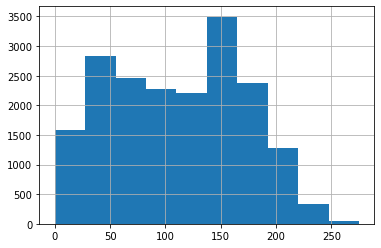

In [ ]:
plot_character_length_histogram(text)

In [ ]:
plt.savefig('character-length-histogram.png', dpi=300)

<Figure size 432x288 with 0 Axes>

### Word Number Histogram

In [ ]:
def plot_word_number_histogram(text):
    text.str.split().\
        map(lambda x: len(x)).\
        hist()

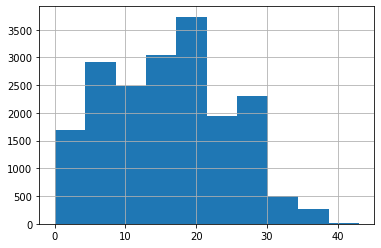

In [ ]:
plot_word_number_histogram(text)

In [ ]:
plt.savefig('word-number-hist.png', dpi=300)

<Figure size 432x288 with 0 Axes>

In [ ]:
plt.rcParams["figure.figsize"] = [8, 10]
plt.rcParams["figure.autolayout"] = True

### Top Non-Stopwords Barchart

In [ ]:
import seaborn as sns
from nltk.corpus import stopwords
from collections import  Counter
from matplotlib import rcParams

def plot_top_non_stopwords_barchart(text):
    stop=set(stopwords.words('english'))
    
    new= text.str.split()
    new=new.values.tolist()
    corpus=[word for i in new for word in i]

    counter=Counter(corpus)
    most=counter.most_common()
    x, y=[], []
    for word,count in most[:40]:
        if (word not in stop):
            x.append(word)
            y.append(count)
    rcParams['figure.figsize'] = 8,10        
    sns.barplot(x=y,y=x)

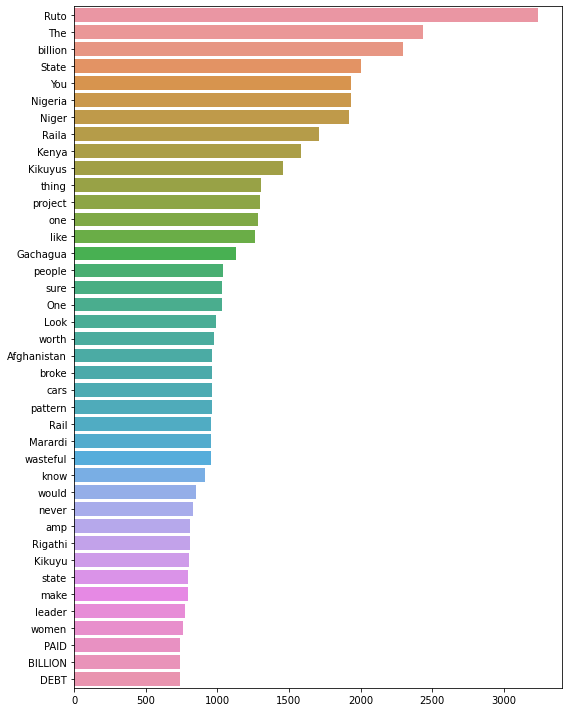

In [ ]:
plot_top_non_stopwords_barchart(text)

In [ ]:
plt.savefig('non-stop-words.png', dpi=300)

<Figure size 576x720 with 0 Axes>

# Top N-grams Barchart

In [ ]:
import seaborn as sns
import numpy as np
from nltk.corpus import stopwords
from sklearn.feature_extraction.text import CountVectorizer
from collections import  Counter

def plot_top_ngrams_barchart(text, n=2):
    stop=set(stopwords.words('english'))

    new= text.str.split()
    new=new.values.tolist()
    corpus=[word for i in new for word in i]

    def _get_top_ngram(corpus, n=None):
        vec = CountVectorizer(ngram_range=(n, n)).fit(corpus)
        bag_of_words = vec.transform(corpus)
        sum_words = bag_of_words.sum(axis=0) 
        words_freq = [(word, sum_words[0, idx]) 
                      for word, idx in vec.vocabulary_.items()]
        words_freq =sorted(words_freq, key = lambda x: x[1], reverse=True)
        return words_freq[:10]

    top_n_bigrams=_get_top_ngram(text,n)[:10]
    x,y=map(list,zip(*top_n_bigrams))
    sns.barplot(x=y,y=x)

In [ ]:
plt.savefig('n-grams.png', dpi=300)

<Figure size 576x720 with 0 Axes>

### Bigrams

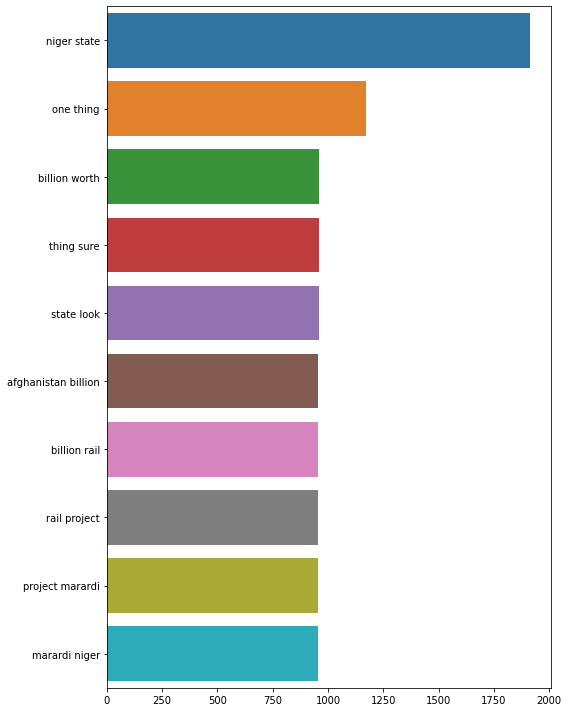

In [ ]:
plot_top_ngrams_barchart(text,2)

In [ ]:
plt.savefig('bi-grams.png', dpi=300)

<Figure size 576x720 with 0 Axes>

### Trigrams

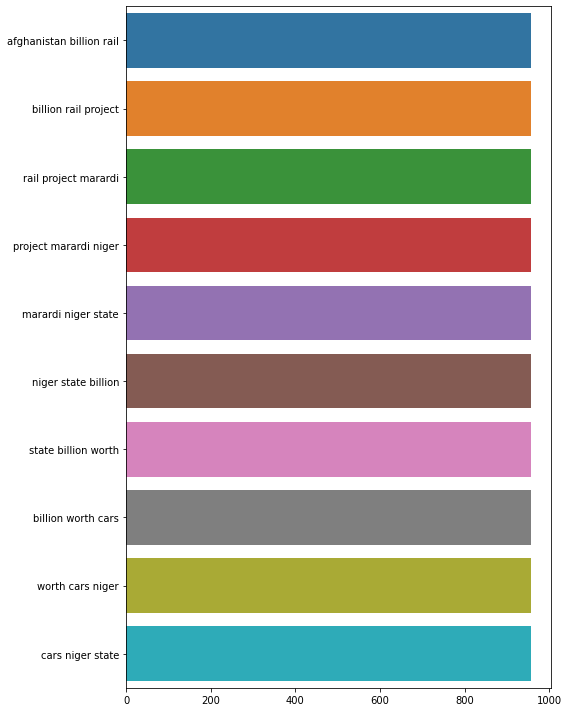

In [ ]:
plot_top_ngrams_barchart(text,3)

In [ ]:
plt.savefig('tri-grams.png', dpi=300)

<Figure size 576x720 with 0 Axes>

# Topic Modelling LDA visualization

In [ ]:
import nltk
nltk.download('punkt')
nltk.download('wordnet')
nltk.download('omw-1.4')


[nltk_data] Downloading package punkt to /home/azureuser/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package wordnet to
[nltk_data]     /home/azureuser/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package omw-1.4 to
[nltk_data]     /home/azureuser/nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!


True

In [ ]:
import pyLDAvis
import pyLDAvis.sklearn
pyLDAvis.enable_notebook()

In [ ]:
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer
from sklearn.decomposition import LatentDirichletAllocation

In [ ]:
tf_vectorizer = CountVectorizer(strip_accents = 'unicode',
                                stop_words = 'english',
                                lowercase = True,
                                token_pattern = r'\b[a-zA-Z]{3,}\b',
                                max_df = 0.5, 
                                min_df = 10)
dtm_tf = tf_vectorizer.fit_transform(text)
print(dtm_tf.shape)

(18903, 3289)


In [ ]:
tfidf_vectorizer = TfidfVectorizer(**tf_vectorizer.get_params())
dtm_tfidf = tfidf_vectorizer.fit_transform(text)
print(dtm_tfidf.shape)

(18903, 3289)


In [ ]:
# for TF DTM
lda_tf = LatentDirichletAllocation(n_components=20, random_state=0)
lda_tf.fit(dtm_tf)
# for TFIDF DTM
lda_tfidf = LatentDirichletAllocation(n_components=20, random_state=0)
lda_tfidf.fit(dtm_tfidf)

LatentDirichletAllocation(batch_size=128, doc_topic_prior=None,
                          evaluate_every=-1, learning_decay=0.7,
                          learning_method='batch', learning_offset=10.0,
                          max_doc_update_iter=100, max_iter=10,
                          mean_change_tol=0.001, n_components=20, n_jobs=None,
                          perp_tol=0.1, random_state=0, topic_word_prior=None,
                          total_samples=1000000.0, verbose=0)

In [ ]:

pyLDAvis.sklearn.prepare(lda_tfidf, dtm_tfidf, tfidf_vectorizer)

PreparedData(topic_coordinates=              x         y  topics  cluster      Freq
topic                                               
11    -0.323833 -0.214651       1        1  7.354329
15    -0.173561 -0.037790       2        1  6.239326
14     0.131869 -0.058679       3        1  6.068991
13     0.136415 -0.025330       4        1  5.745262
18    -0.119081  0.298854       5        1  5.555617
19     0.139297 -0.075422       6        1  5.484546
17     0.097674 -0.074429       7        1  5.461381
0      0.017507  0.155440       8        1  5.301222
7     -0.070276 -0.023460       9        1  5.157892
3     -0.099298 -0.057736      10        1  4.907706
4      0.068497 -0.002071      11        1  4.825595
2      0.111842 -0.077601      12        1  4.656088
8      0.115774  0.012453      13        1  4.483840
6     -0.035795  0.090349      14        1  4.467933
16     0.033331 -0.021135      15        1  4.380032
1      0.060268 -0.085827      16        1  4.335474
5     -0.070752  0.108175      17        1  4.177890
12    -0.022676  0.019605      18        1  3.983443
10    -0.038703 -0.001231      19        1  3.729887
9      0.041499  0.070485      20        1  3.683545, topic_info=         Term        Freq       Total Category  logprob  loglift
289   billion  457.000000  457.000000  Default  30.0000  30.0000
2010  nigeria  344.000000  344.000000  Default  29.0000  29.0000
2009    niger  343.000000  343.000000  Default  28.0000  28.0000
2701    state  413.000000  413.000000  Default  27.0000  27.0000
3239    worth  174.000000  174.000000  Default  26.0000  26.0000
...       ...         ...         ...      ...      ...      ...
1469    kisii   13.299705   30.217147  Topic20  -5.0823   2.4806
1197     huko   12.460933   30.316766  Topic20  -5.1474   2.4122
189    attack   10.590247   21.584605  Topic20  -5.3101   2.5892
2482     ruto   15.264709  425.284830  Topic20  -4.9445  -0.0259
3204  william   11.041010  103.148195  Topic20  -5.2684   1.0667

[1066 rows x 6 columns], token_table=      Topic      Freq       Term
term                            
2         6  0.915445       able
5         5  0.977044      abuse
5         8  0.014583      abuse
13        4  0.134157  according
13       14  0.804945  according
...     ...       ...        ...
3280     18  0.053159       zetu
3280     20  0.026579       zetu
3287     12  0.939240     zombie
3288      2  0.919511       zote
3288      6  0.032840       zote

[2732 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[12, 16, 15, 14, 19, 20, 18, 1, 8, 4, 5, 3, 9, 7, 17, 2, 6, 13, 11, 10])

# Wordcloud

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
from nltk.corpus import stopwords
from nltk.stem import WordNetLemmatizer,PorterStemmer
from nltk.tokenize import word_tokenize
from wordcloud import WordCloud, STOPWORDS
import nltk

def plot_wordcloud(text):
    nltk.download('stopwords')
    stop=set(stopwords.words('english'))

    def _preprocess_text(text):
        corpus=[]
        stem=PorterStemmer()
        lem=WordNetLemmatizer()
        for news in text:
            words=[w for w in word_tokenize(news) if (w not in stop)]

            words=[lem.lemmatize(w) for w in words if len(w)>2]

            corpus.append(words)
        return corpus
    
    corpus=_preprocess_text(text)
    
    wordcloud = WordCloud(
        background_color='white',
        stopwords=set(STOPWORDS),
        max_words=100,
        max_font_size=30, 
        scale=3,
        random_state=1)
    
    wordcloud=wordcloud.generate(str(corpus))

    fig = plt.figure(1, figsize=(12, 12))
    plt.axis('off')
 
    plt.imshow(wordcloud)
    plt.show()

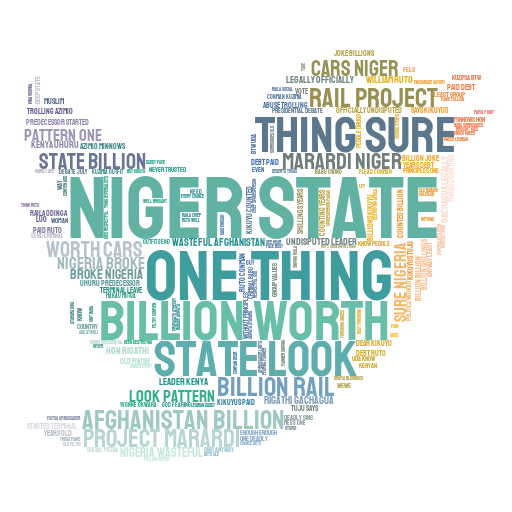

In [ ]:
data=" ".join([i for i in data['text'].str.upper()]) 
stylecloud.gen_stylecloud(data, icon_name= "fab fa-twitter", background_color='white',gradient='horizontal', stopwords = True,output_name = 'hate.png') 
Image('hate.png')

# Text Sentiment

### Polarity Histogram

In [ ]:
from textblob import TextBlob
    
def plot_polarity_histogram(text):
    
    def _polarity(text):
        return TextBlob(text).sentiment.polarity
        
    polarity_score =text.apply(lambda x : _polarity(x))
    polarity_score.hist()

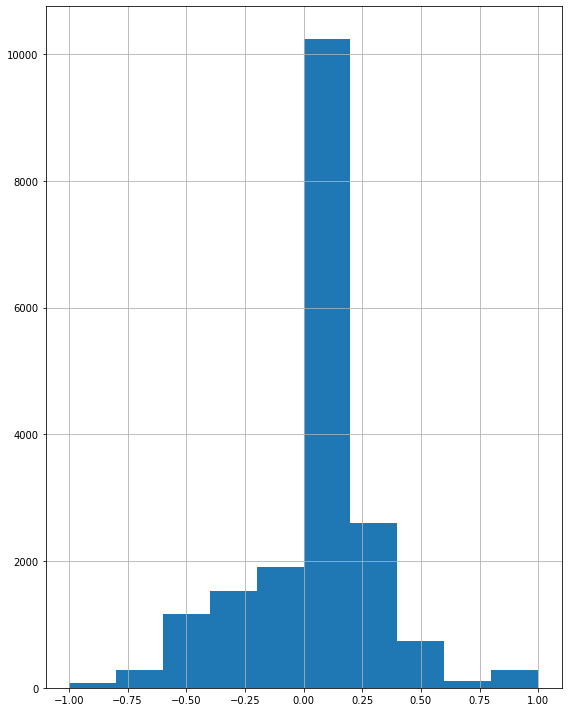

In [ ]:
plot_polarity_histogram(text)

In [ ]:
plt.savefig('sentiment-polarity.png', dpi=300)

<Figure size 576x720 with 0 Axes>

### Sentiment Barchart

In [ ]:
from textblob import TextBlob
import matplotlib.pyplot as plt
from nltk.sentiment.vader import SentimentIntensityAnalyzer
import nltk

def sentiment_vader(text, sid):
    ss = sid.polarity_scores(text)
    ss.pop('compound')
    return max(ss, key=ss.get)

def sentiment_textblob(text):
        x = TextBlob(text).sentiment.polarity
        
        if x<0:
            return 'neg'
        elif x==0:
            return 'neu'
        else:
            return 'pos'

def plot_sentiment_barchart(text, method='TextBlob'):
    if method == 'TextBlob':
        sentiment = text.map(lambda x: sentiment_textblob(x))
    elif method == 'Vader':
        nltk.download('vader_lexicon')
        sid = SentimentIntensityAnalyzer()
        sentiment = text.map(lambda x: sentiment_vader(x, sid=sid))
    else:
        raise ValueError('Textblob or Vader')
    
    plt.bar(sentiment.value_counts().index,
            sentiment.value_counts())

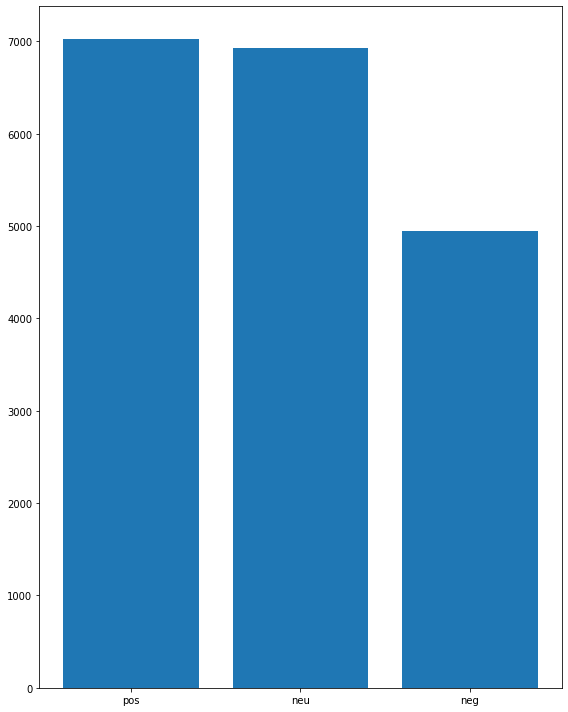

In [ ]:
plot_sentiment_barchart(text, method='TextBlob')

In [ ]:
plt.savefig('sentiment-analysis.png', dpi=300)

<Figure size 576x720 with 0 Axes>

# Named Entity Recognition

### Named Entity Barchart

In [ ]:
import spacy
from collections import  Counter
import seaborn as sns

def plot_named_entity_barchart(text):
    nlp = spacy.load("en_core_web_sm")
    
    def _get_ner(text):
        doc=nlp(text)
        return [X.label_ for X in doc.ents]
    
    ent=text.apply(lambda x : _get_ner(x))
    ent=[x for sub in ent for x in sub]
    counter=Counter(ent)
    count=counter.most_common()
    
    x,y=map(list,zip(*count))
    sns.barplot(x=y,y=x)

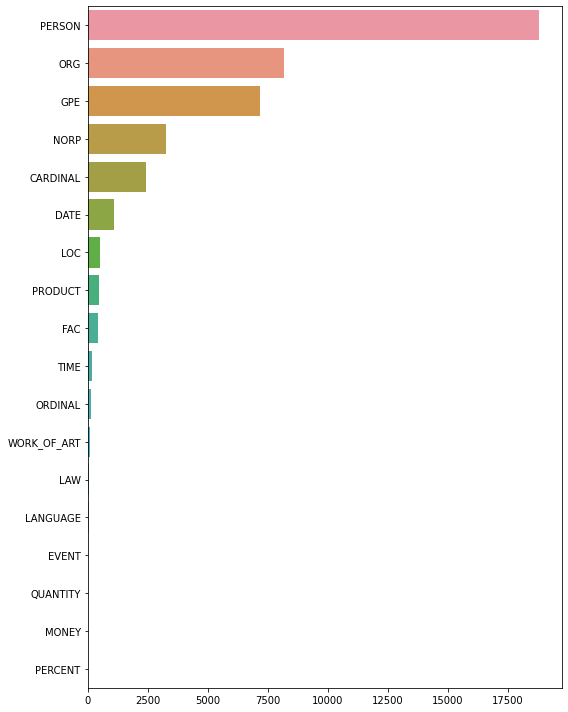

In [ ]:
plot_named_entity_barchart(text)

In [ ]:
plt.savefig('NER.png', dpi=300)

<Figure size 576x720 with 0 Axes>

In [ ]:
!python -m spacy validate

✔ Loaded compatibility table

====================== Installed models (spaCy v2.2.4) ======================
ℹ spaCy installation:
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/spacy

TYPE      NAME             MODEL            VERSION                            
package   en-core-web-sm   en_core_web_sm   2.2.5   ✔



### Most Common Entity

/anaconda/envs/azureml_py38/lib/python3.8/site-packages/past/builtins/misc.py:45: DeprecationWarning: the imp module is deprecated in favour of importlib; see the module's documentation for alternative uses
  from imp import reload
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/sklearn/linear_model/_least_angle.py:30: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  method='lar', copy_X=True, eps=np.finfo(np.float).eps,
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/sklearn/linear_model/_least_angle.py:169: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will 

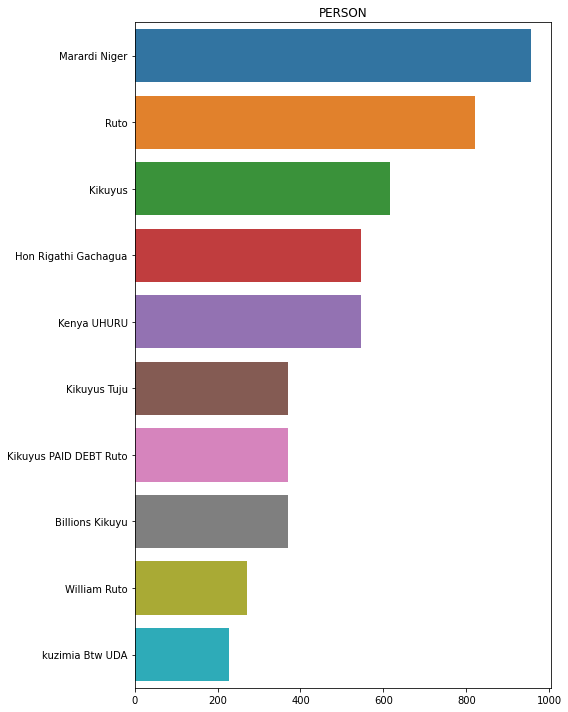

<Figure size 576x720 with 0 Axes>

<Figure size 576x720 with 0 Axes>

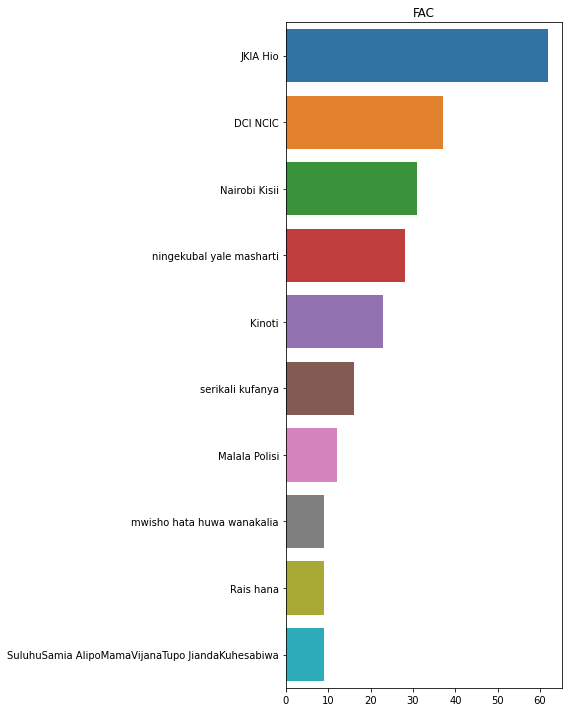

<Figure size 576x720 with 0 Axes>

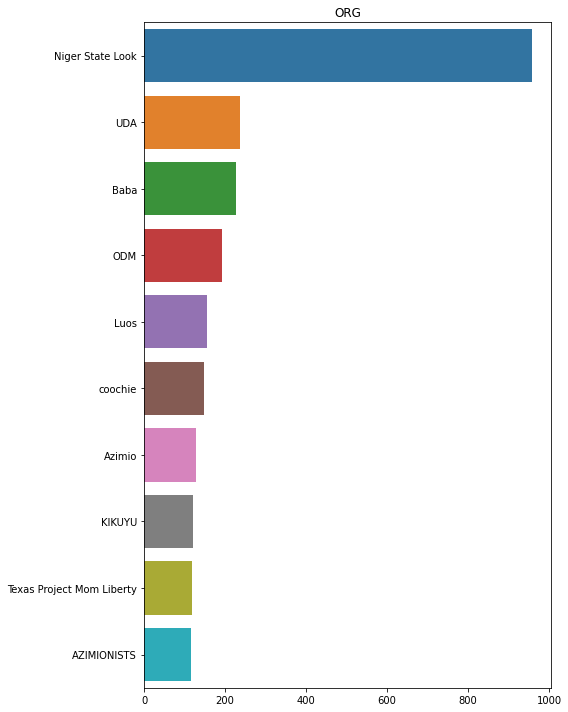

<Figure size 576x720 with 0 Axes>

<Figure size 576x720 with 0 Axes>

<Figure size 576x720 with 0 Axes>

<Figure size 576x720 with 0 Axes>

<Figure size 576x720 with 0 Axes>

<Figure size 576x720 with 0 Axes>

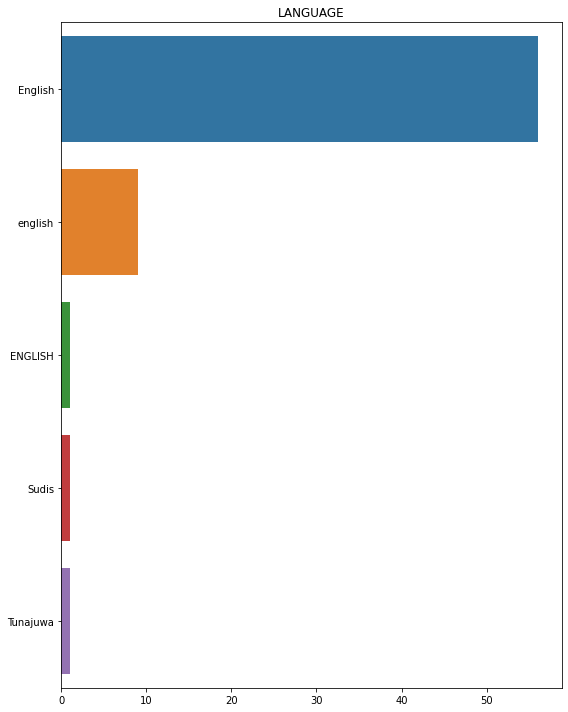

<Figure size 576x720 with 0 Axes>

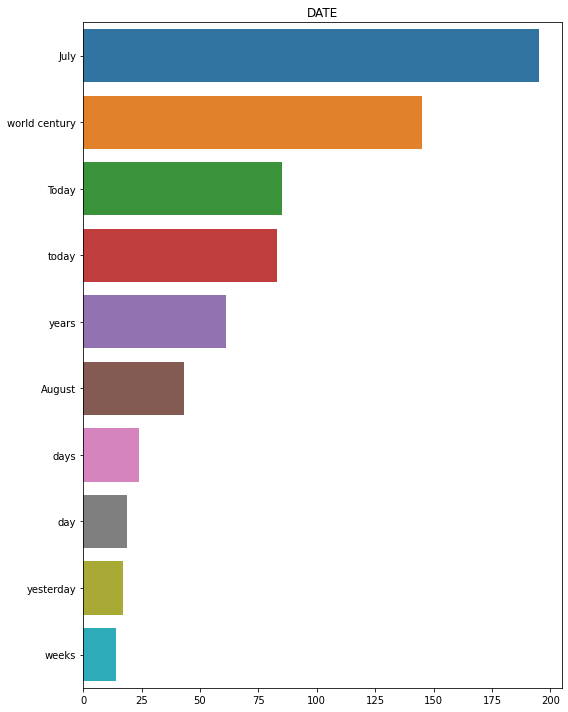

<Figure size 576x720 with 0 Axes>

<Figure size 576x720 with 0 Axes>

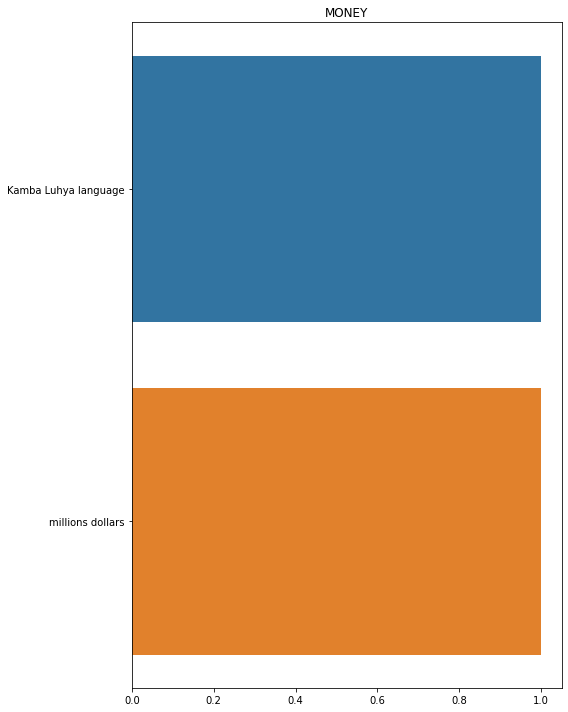

<Figure size 576x720 with 0 Axes>

<Figure size 576x720 with 0 Axes>
<Figure size 576x720 with 0 Axes>

In [ ]:
import spacy
from collections import  Counter
import seaborn as sns
import matplotlib.pyplot as plt

def plot_most_common_named_entity_barchart(text, entity="PERSON"):
    nlp = spacy.load("en_core_web_sm")
    
    def _get_ner(text,ent):
        doc=nlp(text)
        return [X.text for X in doc.ents if X.label_ == ent]

    entity_filtered=text.apply(lambda x: _get_ner(x,entity))
    entity_filtered=[i for x in entity_filtered for i in x]
    
    counter=Counter(entity_filtered)
    x,y=map(list,zip(*counter.most_common(10)))
    sns.barplot(y,x).set_title(entity)

ENTITIES = [
    "PERSON",
    "NORP",
    "FAC",
    "ORG",
    "GPE",
    "LOC",
    "PRODUCT",
    "EVENT",
    "LAW",
    "LANGUAGE",
    "DATE",
    "TIME",
    "MONEY",
    "ORDINAL",
    "CARDINAL"
]

for entity in ENTITIES:
    try:
        fig = plt.figure()
        plot_most_common_named_entity_barchart(text, entity)
        plt.show()
        plt.savefig('entities.png', dpi=300)
    except Exception:
        pass

# Parts of Speech Tagging (POS)

#### Most Common POS

[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     /home/azureuser/nltk_data...
[nltk_data]   Package averaged_perceptron_tagger is already up-to-
[nltk_data]       date!


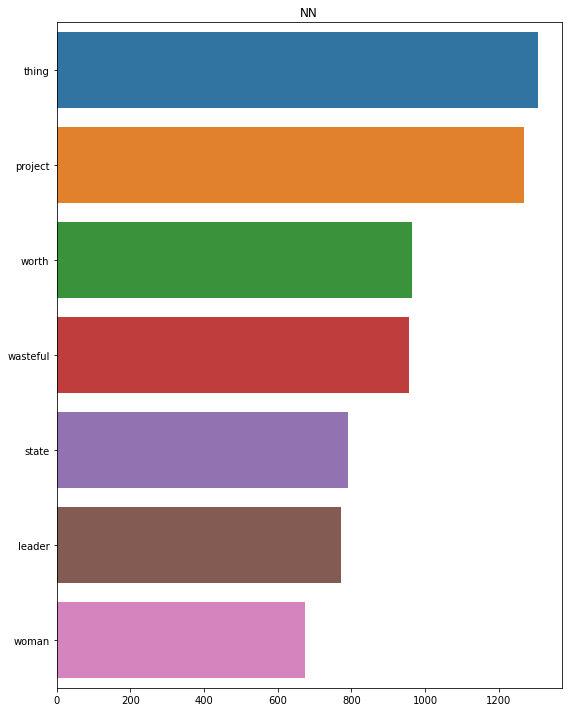

[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     /home/azureuser/nltk_data...
[nltk_data]   Package averaged_perceptron_tagger is already up-to-
[nltk_data]       date!
[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     /home/azureuser/nltk_data...
[nltk_data]   Package averaged_perceptron_tagger is already up-to-
[nltk_data]       date!
[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     /home/azureuser/nltk_data...
[nltk_data]   Package averaged_perceptron_tagger is already up-to-
[nltk_data]       date!
[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     /home/azureuser/nltk_data...
[nltk_data]   Package averaged_perceptron_tagger is already up-to-
[nltk_data]       date!
[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     /home/azureuser/nltk_data...
[nltk_data]   Package averaged_perceptron_tagger is already up-to-
[nltk_data]       date!


<Figure size 576x720 with 0 Axes>
<Figure size 576x720 with 0 Axes>
<Figure size 576x720 with 0 Axes>
<Figure size 576x720 with 0 Axes>
<Figure size 576x720 with 0 Axes>

<Figure size 576x720 with 0 Axes>

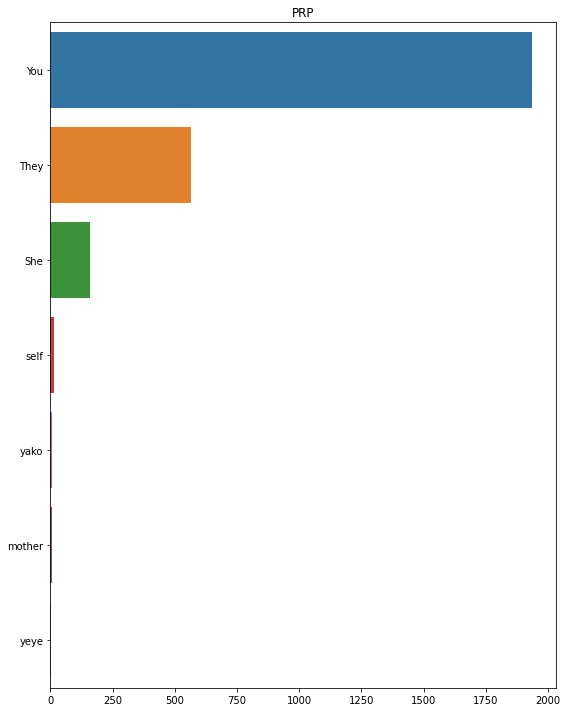

<Figure size 576x720 with 0 Axes>

<Figure size 576x720 with 0 Axes>

In [ ]:
import nltk
from nltk.tokenize import word_tokenize
import seaborn as sns
from collections import Counter

def plot_most_common_part_of_speech_barchart(text, part_of_speech='NN'):
    nltk.download('averaged_perceptron_tagger')
    
    def _filter_pos(text):
        pos_type=[]
        pos=nltk.pos_tag(word_tokenize(text))
        for word,tag in pos:
            if tag==part_of_speech:
                pos_type.append(word)
        return pos_type


    words=text.apply(lambda x : _filter_pos(x))
    words=[x for l in words for x in l]
    counter=Counter(words)
    x,y=list(map(list,zip(*counter.most_common(7))))
    sns.barplot(x=y,y=x).set_title(part_of_speech)


PARTS_OF_SPEECH = [
    "NN",
    "VB",
    "JJ",
    "RB",
    "IN",
    "CC",
    "PRP",
    "INT",
]

for part_of_speech in PARTS_OF_SPEECH:
    try:
        fig = plt.figure()
        plot_most_common_part_of_speech_barchart(text, part_of_speech)
        plt.show()
        plt.savefig('pos.png', dpi=300)
    except Exception:
        pass

# Text Complexity

### Text Complexity Histogram

In [ ]:
pip install textstat

Note: you may need to restart the kernel to use updated packages.


In [ ]:
import textstat
from textstat import flesch_reading_ease

def plot_text_complexity_histogram(text):
    text.\
        apply(lambda x : flesch_reading_ease(x)).\
        hist()

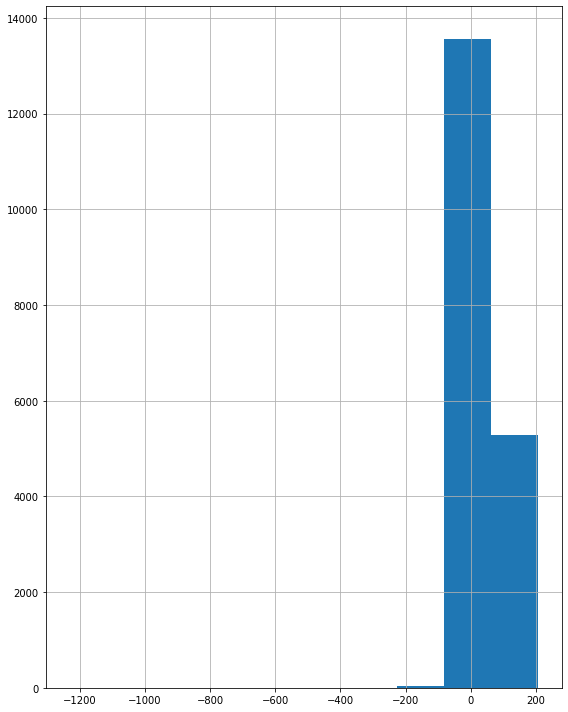

In [ ]:
plot_text_complexity_histogram(text)

In [ ]:
plt.savefig('text-complex.png', dpi=300)

<Figure size 576x720 with 0 Axes>